# **Deep Learning Assignment-1**

# **By Sumeet Mishra**

## **Question 1 : MNIST Classification**

Importing tensorflow library and defining the hidden layers along with the number of units, the input and output units.

In [0]:
import tensorflow as tf
#print(tf.__version__)
n_inputs = 28*28 
n_hidden1 = 1024 
n_hidden2 = 1024
n_hidden3 = 1024
n_hidden4 = 1024
n_hidden5 = 1024
n_outputs = 10

Defining placeholders X and y to pass during traing the model.

In [0]:
X = tf.placeholder(tf.float32, shape=(None, n_inputs), name="X")
y = tf.placeholder(tf.int64, shape=(None), name="y")

Importing fully_connected neural network layers from tensorflow.contrib.layers library. Making the connection between layers. The fully_connected layers use ReLU as default activation function. So, I have used ReLU for all the hidden layers and linear activation function for output layer(that is activation_fn=None for logits layer).

In [0]:
from tensorflow.contrib.layers import fully_connected
with tf.name_scope("dnn"):
    hidden1 = fully_connected(X, n_hidden1, scope="hidden1") 
    hidden2 = fully_connected(hidden1, n_hidden2, scope="hidden2")
    hidden3 = fully_connected(hidden2, n_hidden3, scope="hidden3")
    hidden4 = fully_connected(hidden3, n_hidden4, scope="hidden4")
    hidden5 = fully_connected(hidden4, n_hidden5, scope="hidden5")
    logits = fully_connected(hidden5, n_outputs, scope="outputs",activation_fn=None)

Defining the loss function with softmax_cross_entropy.

In [4]:
with tf.name_scope("loss"):
        xentropy = tf.nn.softmax_cross_entropy_with_logits(labels=y, logits=logits)
        loss = tf.reduce_mean(xentropy, name="loss")

Instructions for updating:

Future major versions of TensorFlow will allow gradients to flow
into the labels input on backprop by default.

See `tf.nn.softmax_cross_entropy_with_logits_v2`.



Defining the learning rate and optimizer to reduce the loss. I have used gradient descent for the optimizer.

In [0]:
learning_rate = 0.01
with tf.name_scope("train"):
    optimizer = tf.train.GradientDescentOptimizer(learning_rate) 
    training_op = optimizer.minimize(loss)

Defining correct prediction and accuracy to be calculated. Also initialized global variables. 

In [0]:
with tf.name_scope("eval"):
    correct_pred = tf.equal(tf.math.argmax(logits,1),tf.math.argmax(y,1))
    accuracy = tf.reduce_mean(tf.cast(correct_pred, tf.float32))

init = tf.global_variables_initializer()
saver = tf.train.Saver()    

Imported MNIST data with one hot encoding which will form the categorical data in a way which could be provided to the model.

In [28]:
from tensorflow.examples.tutorials.mnist import input_data 
mnist = input_data.read_data_sets('MNIST_data', one_hot=True)

Extracting MNIST_data/train-images-idx3-ubyte.gz
Extracting MNIST_data/train-labels-idx1-ubyte.gz
Extracting MNIST_data/t10k-images-idx3-ubyte.gz
Extracting MNIST_data/t10k-labels-idx1-ubyte.gz


Defining number of epochs and batch size.

In [0]:
n_epochs = 40
batch_size = 50

Training the model with images from MNIST training samples. Calculating train accuracy and Saving the model as a checkpoint file. 

In [30]:
with tf.Session() as sess: 
    init.run()
    for epoch in range(n_epochs):
        for iteration in range(mnist.train.num_examples // batch_size):
                X_batch, y_batch = mnist.train.next_batch(batch_size)
                sess.run(training_op, feed_dict={X: X_batch, y: y_batch})
        acc_train = accuracy.eval(feed_dict={X: X_batch, y: y_batch})
        print('Epoch',epoch, "Train accuracy:", acc_train)
    save_path = saver.save(sess, "./my_model_final.ckpt")
    

    

Epoch 0 Train accuracy: 0.94
Epoch 1 Train accuracy: 1.0
Epoch 2 Train accuracy: 1.0
Epoch 3 Train accuracy: 0.94
Epoch 4 Train accuracy: 1.0
Epoch 5 Train accuracy: 0.98
Epoch 6 Train accuracy: 0.98
Epoch 7 Train accuracy: 1.0
Epoch 8 Train accuracy: 1.0
Epoch 9 Train accuracy: 1.0
Epoch 10 Train accuracy: 1.0
Epoch 11 Train accuracy: 1.0
Epoch 12 Train accuracy: 1.0
Epoch 13 Train accuracy: 1.0
Epoch 14 Train accuracy: 1.0
Epoch 15 Train accuracy: 1.0
Epoch 16 Train accuracy: 1.0
Epoch 17 Train accuracy: 1.0
Epoch 18 Train accuracy: 1.0
Epoch 19 Train accuracy: 1.0
Epoch 20 Train accuracy: 1.0
Epoch 21 Train accuracy: 1.0
Epoch 22 Train accuracy: 1.0
Epoch 23 Train accuracy: 1.0
Epoch 24 Train accuracy: 1.0
Epoch 25 Train accuracy: 1.0
Epoch 26 Train accuracy: 1.0
Epoch 27 Train accuracy: 1.0
Epoch 28 Train accuracy: 1.0
Epoch 29 Train accuracy: 1.0
Epoch 30 Train accuracy: 1.0
Epoch 31 Train accuracy: 1.0
Epoch 32 Train accuracy: 1.0
Epoch 33 Train accuracy: 1.0
Epoch 34 Train accur

Restoring the model from the checkpoint file and running test samples to find accuracy of the model.

In [31]:
with tf.Session() as sess:
    init.run()
    saver.restore(sess, "./my_model_final.ckpt")
    for epoch in range(n_epochs): 
      acc_test1 = accuracy.eval(feed_dict={X: mnist.test.images[:1000],y: mnist.test.labels[:1000]})
    print("Epoch:",epoch, "Test accuracy1:", acc_test1)

INFO:tensorflow:Restoring parameters from ./my_model_final.ckpt
Epoch: 39 Test accuracy1: 0.983


Taking random 1000 test samples from MNIST to run inference on the trained model by passing them to the model.

In [32]:
import random
mnist_t_1000=random.sample(list(mnist.test.images),1000) 
with tf.Session() as sess: 
  init.run() 
  saver.restore(sess, "./my_model_final.ckpt") 
  infer=sess.run(logits, feed_dict={X:mnist_t_1000})

INFO:tensorflow:Restoring parameters from ./my_model_final.ckpt


Importing numpy library to use argmax function to get the best predicted image out of 10 possibilities. 

In [33]:
import numpy as np
infer_result=np.argmax(infer,axis=1)
print(infer_result)
infer_result.shape

[9 6 4 1 9 8 3 6 9 2 0 0 6 8 9 6 3 7 2 2 7 7 0 6 7 2 1 8 5 9 7 7 0 8 8 3 7
 2 6 2 5 0 5 4 9 5 7 0 3 8 8 9 6 9 4 6 4 3 1 8 0 9 6 9 6 0 3 3 5 8 0 1 2 6
 4 7 9 6 4 9 3 8 9 2 7 3 2 7 9 7 3 8 3 9 1 1 4 1 3 9 5 3 0 3 7 7 4 2 3 4 3
 8 5 8 8 6 5 4 3 6 2 8 1 7 2 5 7 5 7 2 4 6 9 0 8 2 6 1 0 9 1 1 1 3 5 1 1 3
 8 5 3 8 1 8 9 4 7 9 2 0 4 2 2 7 1 5 2 6 7 1 0 1 5 4 1 8 1 6 3 2 4 2 2 9 0
 9 4 8 4 2 6 9 2 0 4 1 0 2 0 2 3 4 5 7 6 0 0 7 6 1 1 3 2 0 0 4 0 5 9 4 6 3
 6 9 0 9 8 5 1 1 4 8 1 2 7 8 2 9 2 3 2 8 1 8 0 5 2 4 9 8 9 2 6 1 4 0 4 5 0
 3 6 9 1 3 4 9 1 5 0 6 0 0 2 9 5 4 7 0 0 9 1 8 0 2 7 4 7 2 0 1 3 2 3 4 1 7
 1 5 6 0 7 4 8 0 7 7 7 3 1 2 7 0 0 8 2 6 6 1 9 7 6 4 2 5 5 8 9 2 8 6 0 7 4
 0 0 3 1 5 3 8 6 9 1 9 3 1 7 0 0 0 4 6 8 8 4 3 0 7 6 0 2 0 6 5 9 9 4 7 9 9
 6 2 2 6 9 4 1 9 1 9 2 0 9 5 8 7 1 1 8 1 5 6 4 5 8 1 0 6 5 1 7 2 7 7 8 3 4
 5 2 3 6 4 1 0 2 1 4 2 0 3 1 4 0 1 3 0 5 1 1 7 6 2 1 3 9 3 7 0 5 8 3 5 8 9
 8 4 6 0 1 0 9 2 2 5 3 6 3 7 6 7 7 4 9 9 9 4 9 9 3 4 7 8 1 5 1 6 4 8 0 9 2
 4 3 1 9 2 0 4 0 6 8 1 2 

(1000,)

Making predicted output and it's index pair to put into an array and sorting them according to the predicted image. It will be helpful in getting 10 predictions in each category.

In [34]:
result=[]
result_final=[]
l=0
counter=0
for i,v in enumerate(infer_result):
  result.append((i,v))
result=sorted(result,key=lambda x:x[1]) 
for i in range(len(result)):
  if counter>9:
    counter=0
    l+=1
  if result[i][1]==l and counter<=9:
    result_final.append(result[i])
    counter+=1   
print(result_final)

[(10, 0), (11, 0), (22, 0), (32, 0), (41, 0), (47, 0), (60, 0), (65, 0), (70, 0), (102, 0), (3, 1), (26, 1), (58, 1), (71, 1), (94, 1), (95, 1), (97, 1), (122, 1), (137, 1), (140, 1), (9, 2), (18, 2), (19, 2), (25, 2), (37, 2), (39, 2), (72, 2), (83, 2), (86, 2), (107, 2), (6, 3), (16, 3), (35, 3), (48, 3), (57, 3), (66, 3), (67, 3), (80, 3), (85, 3), (90, 3), (2, 4), (43, 4), (54, 4), (56, 4), (74, 4), (78, 4), (96, 4), (106, 4), (109, 4), (117, 4), (28, 5), (40, 5), (42, 5), (45, 5), (68, 5), (100, 5), (112, 5), (116, 5), (125, 5), (127, 5), (1, 6), (7, 6), (12, 6), (15, 6), (23, 6), (38, 6), (52, 6), (55, 6), (62, 6), (64, 6), (17, 7), (20, 7), (21, 7), (24, 7), (30, 7), (31, 7), (36, 7), (46, 7), (75, 7), (84, 7), (5, 8), (13, 8), (27, 8), (33, 8), (34, 8), (49, 8), (50, 8), (59, 8), (69, 8), (81, 8), (0, 9), (4, 9), (8, 9), (14, 9), (29, 9), (44, 9), (51, 9), (53, 9), (61, 9), (63, 9)]


Plotting the input images which was taken from the (index,predicted value) pair.  

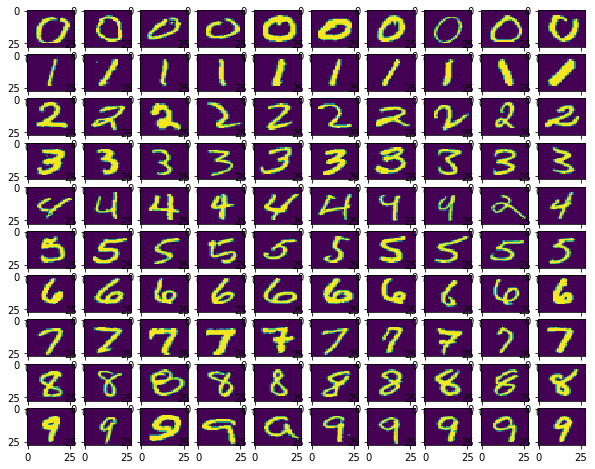

In [35]:
import matplotlib.pyplot as plt
fig,ax = plt.subplots(10,10,figsize=(10, 8)) 
k = 0
for i in range(10): 
   for j in range(10):
      if (result_final[k][1]==i):
        ax[i][j].imshow(mnist_t_1000[result_final[k][0]].reshape(28,28), aspect='auto') 
      k += 1  
plt.show()

Taking input from hidden layer 5 to run inference on them. This input have a different shape than the input taken from last layer. 

In [36]:
with tf.Session() as sess: 
  init.run() 
  saver.restore(sess, "./my_model_final.ckpt") 
  infer_prev=sess.run(hidden5, feed_dict={X:mnist_t_1000})

INFO:tensorflow:Restoring parameters from ./my_model_final.ckpt


In [37]:
infer_prev.shape

(1000, 1024)

Choosing 10 inputs randomly out of 1024 by transposing the matrix.  

In [0]:
infer_prev_t=np.transpose(infer_prev)
infer_prev_t_final=infer_prev_t[np.random.choice(infer_prev_t.shape[0],10),:]

infer_prev_final=np.transpose(infer_prev_t_final)


Taken the best predicted value out of 10 predictions and discarded the rest.

In [39]:
infer_prev_result=np.argmax(infer_prev_final,axis=1)
print(infer_prev_result)
infer_prev_result.shape

[4 0 2 4 4 1 9 7 9 3 0 0 0 9 1 6 9 1 1 0 2 2 0 0 4 1 4 7 9 7 2 2 0 9 4 9 1
 8 0 3 9 0 9 2 9 1 2 0 9 4 9 9 0 9 2 0 2 9 1 7 0 9 0 4 0 0 9 9 9 9 0 1 2 6
 2 2 4 0 2 9 9 4 4 1 2 9 1 2 9 1 9 7 9 9 4 4 4 0 9 7 9 9 0 9 2 2 2 8 9 9 9
 1 1 3 9 0 4 2 9 0 8 1 4 4 1 9 2 9 2 0 2 7 9 7 9 0 6 1 7 9 4 4 4 9 7 4 4 9
 9 9 9 1 4 1 4 2 2 9 8 0 2 2 8 2 4 1 1 0 1 4 0 4 9 2 4 9 4 7 9 3 2 8 8 9 7
 9 2 9 2 3 1 9 3 0 2 4 0 2 0 3 9 2 9 2 6 0 0 1 0 4 4 9 2 0 0 2 0 9 4 2 7 9
 0 9 0 9 9 3 1 1 2 9 2 2 2 1 1 9 3 9 8 0 4 0 0 9 0 2 9 1 9 2 0 4 2 0 2 4 0
 9 1 4 1 9 2 4 1 9 0 0 0 0 0 2 9 2 2 0 0 1 4 1 0 2 2 0 1 2 0 4 9 3 9 2 4 2
 4 9 7 0 4 2 3 0 2 2 2 9 1 2 1 0 0 9 1 0 0 4 1 1 7 2 1 9 9 9 4 1 4 0 0 2 2
 0 0 9 4 9 9 9 6 9 4 9 9 4 1 0 0 0 2 0 4 9 2 9 7 1 0 0 8 7 7 1 9 1 2 2 1 2
 0 1 2 0 2 2 4 9 1 9 0 0 9 4 1 2 4 4 1 1 9 7 2 1 3 2 0 0 9 4 1 3 2 2 3 9 2
 9 3 9 0 2 4 0 2 4 2 2 0 9 4 2 0 4 9 0 4 4 4 2 0 1 4 9 9 9 2 0 1 7 9 3 1 9
 3 2 0 0 1 0 2 3 2 9 9 6 9 1 0 2 1 2 9 4 4 2 9 9 9 2 1 7 4 4 1 0 2 7 0 4 8
 2 9 4 9 3 0 2 7 7 9 1 1 

(1000,)

Following the same steps as sorting out the predictions and taking (index,predicted value) pair. Also taking 10 samples(if more than 10 values else all samples) of each category. 

In [0]:
p_result=[]
p_result_final=[]
l=0
counter=0
counter1=0
for i,v in enumerate(infer_prev_result):
  p_result.append((i,v))
p_result=sorted(p_result,key=lambda x:x[1])
counter_array = [0]*10

for i in range(len(p_result)):
  if counter_array[p_result[i][1]] < 10:
    p_result_final.append(p_result[i])
    counter_array[p_result[i][1]] += 1

Plotting the values obtained from previous chunk. This plot may contain some empty spaces and incorrect predicted values but that's how it is supposed to be. 

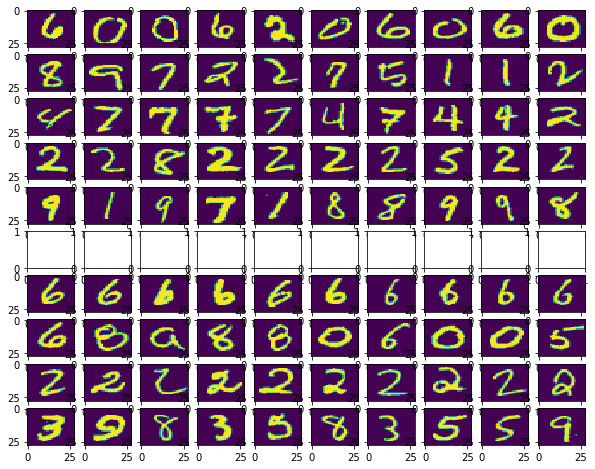

In [41]:
fig,ax = plt.subplots(10,10,figsize=(10, 8)) 
k = 0
i=0
while i<10:
   j=0
   while j<10:
      #print(p_result_final[k][1],i,j)
      if (p_result_final[k][1]!=i and p_result_final[k][1]>i):
        #print(p_result_final[k][1],i,j)
        i=p_result_final[k][1]
        j=0
        #print(p_result_final[k][1],i,j)
      if (p_result_final[k][1]==i):
        #print(p_result_final[k][1],i,j)
        ax[i][j].imshow(mnist_t_1000[p_result_final[k][0]].reshape(28,28), aspect='auto')    
        k += 1
      j+=1  
   i+=1     
plt.show()

Importing TSNE and PCA from sklearn library to do dimension reduction with 2 components. Taking 1st 1000 examples of test samples(both images and labels) to perform dimension reduction and visualize them. 

In [0]:
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
mnist_1000_i=mnist.test.images[:1000]
mnist_1000_l=mnist.test.labels[:1000]

mnist_1000_i_TSNE = TSNE(n_components=2).fit_transform(mnist_1000_i)
mnist_1000_i_pca= PCA(n_components=2).fit_transform(mnist_1000_i)


In [0]:
mnist_1000_l1=np.argmax(mnist_1000_l,axis=1)

Plotting scatter plot by passing images and labels of MNIST 1000 samples.

(<Figure size 576x576 with 1 Axes>,
 [Text(30.068161, -35.500446, '0'),
  Text(0.07588619, 13.160292, '1'),
  Text(-4.9637427, -14.353572, '2'),
  Text(33.58086, -6.5700617, '3'),
  Text(-43.24237, 11.00471, '4'),
  Text(22.844799, -10.430748, '5'),
  Text(17.055721, -25.027077, '6'),
  Text(-25.779247, 12.854917, '7'),
  Text(9.195342, -2.9513206, '8'),
  Text(-41.770004, 12.56723, '9')])

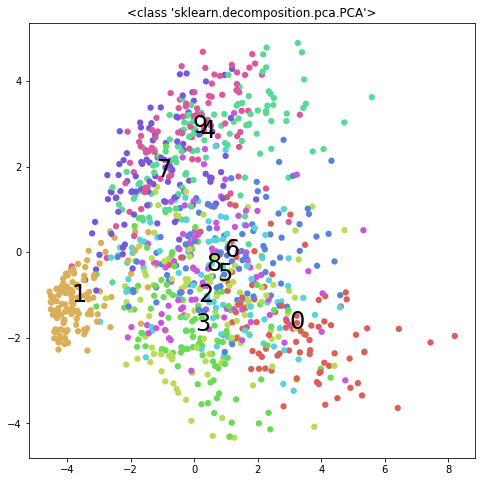

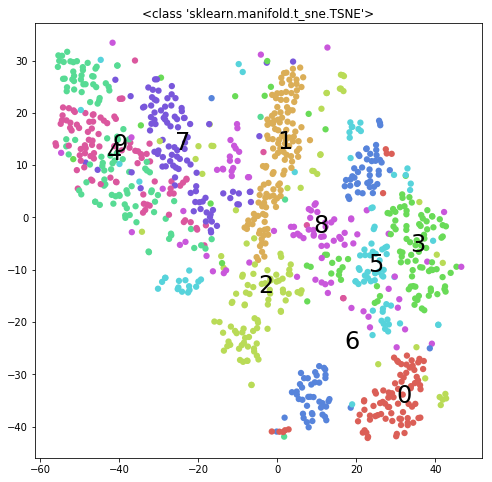

In [44]:
import pandas as pd
import seaborn as sns
import matplotlib.patheffects


def scatter(x, colors,label):
    # We choose a color palette with seaborn.
    palette = np.array(sns.color_palette("hls", 10))

    # We create a scatter plot.
    f = plt.figure(figsize=(8, 8))
    ax = plt.subplot(aspect='equal')
    sc = ax.scatter(x[:,0], x[:,1], lw=0, s=40,c=palette[colors.astype(np.int)])
    plt.title(label)
    plt.xlim(-25, 25)
    plt.ylim(-25, 25)
    #ax.axis('off')
    ax.axis('tight')

    # We add the labels for each digit.
    txts = []
    for i in range(10):
        # Position of each label.
        xtext, ytext = np.median(x[colors == i, :], axis=0)
        txt = ax.text(xtext, ytext, str(i), fontsize=24)
        txts.append(txt)

    return f, ax, sc, txts
   
scatter(mnist_1000_i_pca,mnist_1000_l1,PCA)
scatter(mnist_1000_i_TSNE,mnist_1000_l1,TSNE)



Plotting scatter plots by taking input from hidden layer 1, hidden layer 2, hidden layer 3, hidden layer 4, hidden layer 5. 

INFO:tensorflow:Restoring parameters from ./my_model_final.ckpt


(<Figure size 576x576 with 1 Axes>,
 [Text(-46.389847, 14.472549, '0'),
  Text(35.57253, 7.5970793, '1'),
  Text(9.491411, 12.568494, '2'),
  Text(-14.659679, 23.26938, '3'),
  Text(5.0268273, -29.7635, '4'),
  Text(-25.180279, 12.580322, '5'),
  Text(-22.661598, -10.887544, '6'),
  Text(13.591389, -17.00472, '7'),
  Text(-5.814386, 10.41665, '8'),
  Text(7.13282, -31.110832, '9')])

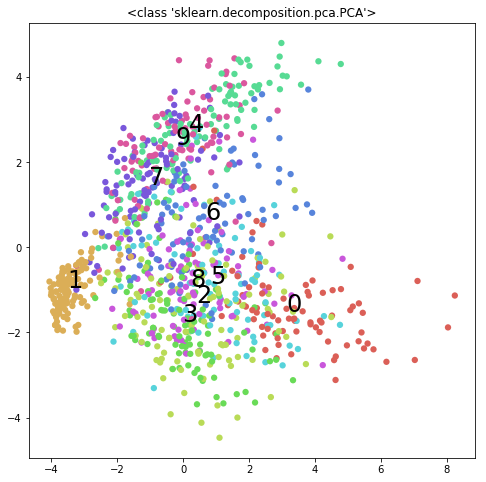

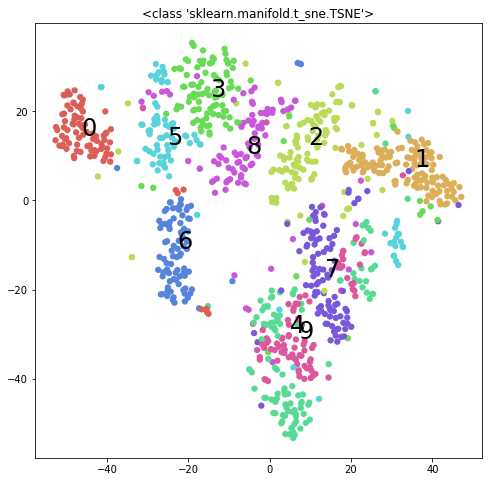

In [45]:
with tf.Session() as sess: 
  init.run() 
  saver.restore(sess, "./my_model_final.ckpt") 
  hidden1_out=sess.run(hidden1, feed_dict={X:mnist_1000_i})
mnist_1000_i_TSNE_h1 = TSNE(n_components=2).fit_transform(hidden1_out)
mnist_1000_i_pca_h1= PCA(n_components=2).fit_transform(hidden1_out)
scatter(mnist_1000_i_pca_h1,mnist_1000_l1,PCA)
scatter(mnist_1000_i_TSNE_h1,mnist_1000_l1,TSNE)

INFO:tensorflow:Restoring parameters from ./my_model_final.ckpt


(<Figure size 576x576 with 1 Axes>,
 [Text(-20.152195, 38.397083, '0'),
  Text(6.7074156, -31.964119, '1'),
  Text(-13.897919, -20.380047, '2'),
  Text(-29.694529, -5.043208, '3'),
  Text(25.136307, 15.89558, '4'),
  Text(-25.044071, 9.8169775, '5'),
  Text(-0.09191796, 27.1382, '6'),
  Text(23.367113, -9.143855, '7'),
  Text(-12.094025, 0.84273726, '8'),
  Text(31.803902, 6.706102, '9')])

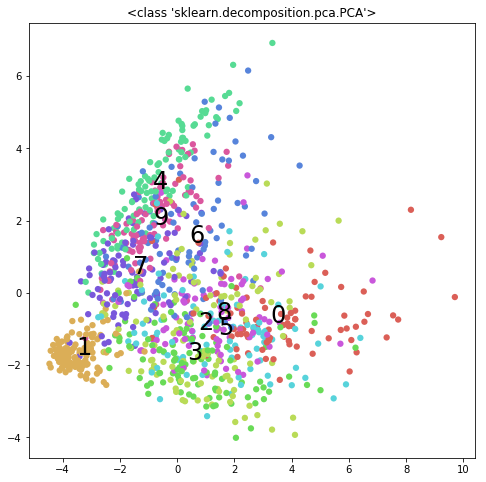

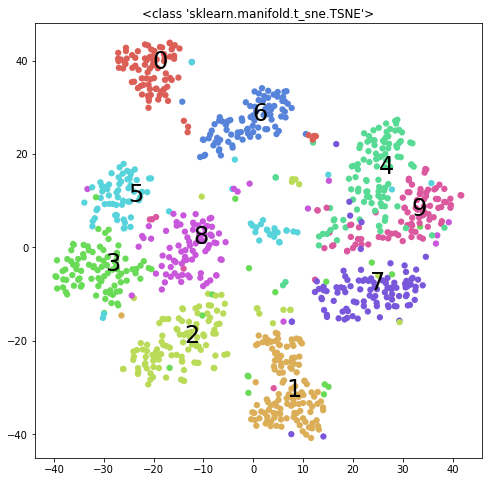

In [46]:
with tf.Session() as sess: 
  init.run() 
  saver.restore(sess, "./my_model_final.ckpt") 
  hidden2_out=sess.run(hidden2, feed_dict={X:mnist_1000_i})
mnist_1000_i_TSNE_h2 = TSNE(n_components=2).fit_transform(hidden2_out)
mnist_1000_i_pca_h2= PCA(n_components=2).fit_transform(hidden2_out)
scatter(mnist_1000_i_pca_h2,mnist_1000_l1,PCA)
scatter(mnist_1000_i_TSNE_h2,mnist_1000_l1,TSNE)


INFO:tensorflow:Restoring parameters from ./my_model_final.ckpt


(<Figure size 576x576 with 1 Axes>,
 [Text(-48.840565, -17.393875, '0'),
  Text(42.29528, 10.111708, '1'),
  Text(19.658566, -8.985465, '2'),
  Text(4.1810417, -31.077026, '3'),
  Text(-18.385183, 25.059116, '4'),
  Text(-13.498801, -26.880873, '5'),
  Text(-30.442001, 0.1534591, '6'),
  Text(14.31511, 18.163637, '7'),
  Text(0.9482101, -7.4310584, '8'),
  Text(-3.035191, 27.668407, '9')])

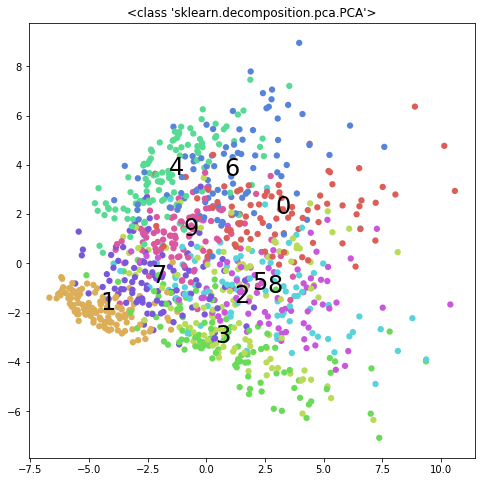

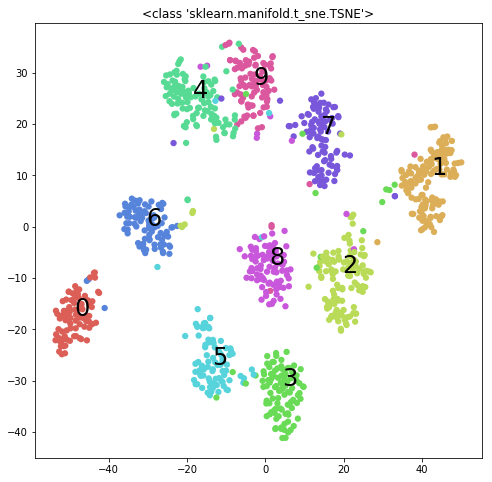

In [47]:
with tf.Session() as sess: 
  init.run() 
  saver.restore(sess, "./my_model_final.ckpt") 
  hidden3_out=sess.run(hidden3, feed_dict={X:mnist_1000_i})
mnist_1000_i_TSNE_h3 = TSNE(n_components=2).fit_transform(hidden3_out)
mnist_1000_i_pca_h3= PCA(n_components=2).fit_transform(hidden3_out)
scatter(mnist_1000_i_pca_h3,mnist_1000_l1,PCA)
scatter(mnist_1000_i_TSNE_h3,mnist_1000_l1,TSNE)

INFO:tensorflow:Restoring parameters from ./my_model_final.ckpt


(<Figure size 576x576 with 1 Axes>,
 [Text(49.464954, -1.0878636, '0'),
  Text(-33.80435, 20.174187, '1'),
  Text(10.207722, -6.2274246, '2'),
  Text(-31.772232, -13.528218, '3'),
  Text(18.222569, 23.956976, '4'),
  Text(-5.916657, -39.341244, '5'),
  Text(26.524078, -24.120022, '6'),
  Text(-5.6060433, 9.918654, '7'),
  Text(-9.861819, -17.529627, '8'),
  Text(1.6026621, 29.163233, '9')])

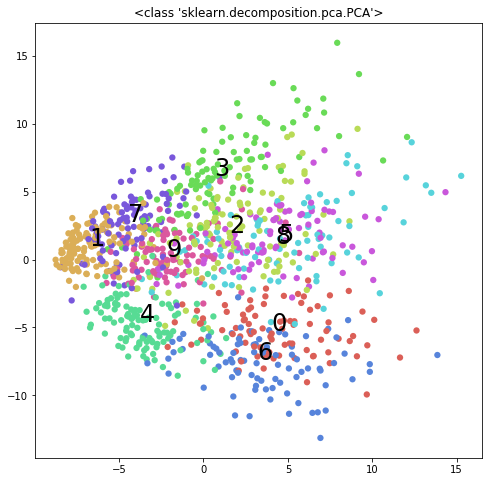

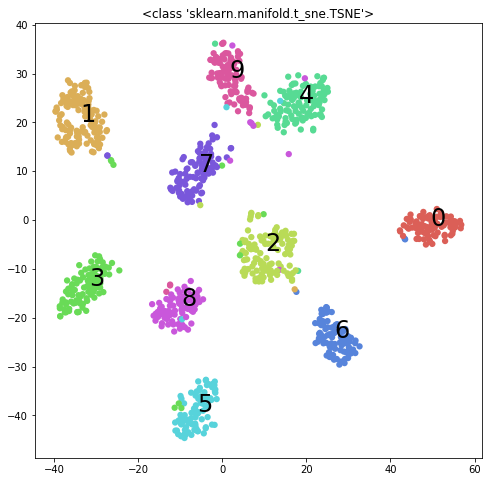

In [48]:
with tf.Session() as sess: 
  init.run() 
  saver.restore(sess, "./my_model_final.ckpt") 
  hidden4_out=sess.run(hidden4, feed_dict={X:mnist_1000_i})
mnist_1000_i_TSNE_h4 = TSNE(n_components=2).fit_transform(hidden4_out)
mnist_1000_i_pca_h4= PCA(n_components=2).fit_transform(hidden4_out)
scatter(mnist_1000_i_pca_h4,mnist_1000_l1,PCA)
scatter(mnist_1000_i_TSNE_h4,mnist_1000_l1,TSNE)

INFO:tensorflow:Restoring parameters from ./my_model_final.ckpt


(<Figure size 576x576 with 1 Axes>,
 [Text(44.49673, 20.577738, '0'),
  Text(-28.915789, -22.760689, '1'),
  Text(15.38484, 21.083172, '2'),
  Text(1.6081029, -35.602436, '3'),
  Text(-17.240868, 30.918892, '4'),
  Text(18.934336, -26.013685, '5'),
  Text(34.274998, -2.3720841, '6'),
  Text(-33.868862, 4.487576, '7'),
  Text(5.8738713, -4.7000895, '8'),
  Text(-10.816126, 7.759182, '9')])

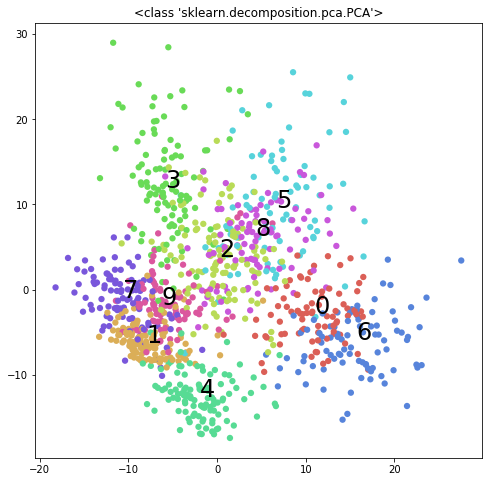

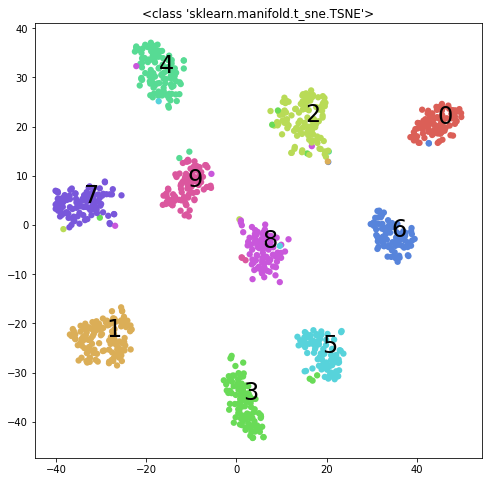

In [49]:
with tf.Session() as sess: 
  init.run() 
  saver.restore(sess, "./my_model_final.ckpt") 
  hidden5_out=sess.run(hidden5, feed_dict={X:mnist_1000_i})
mnist_1000_i_TSNE_h5 = TSNE(n_components=2).fit_transform(hidden5_out)
mnist_1000_i_pca_h5= PCA(n_components=2).fit_transform(hidden5_out)
scatter(mnist_1000_i_pca_h5,mnist_1000_l1,PCA)
scatter(mnist_1000_i_TSNE_h5,mnist_1000_l1,TSNE)

From the plots, we can observe that the plots are getting better with increase of hidden layer and best at hidden layer 5. Also, the TSNE perform better than PCA.

## **Question 2: Speech Denoising**

Importing librosa library.

In [0]:
#!pip install librosa # in colab, you’ll need to install this
import librosa


Uploading input audio files to the google colab.

In [52]:
from google.colab import files
files.upload()

Saving train_dirty_male.wav to train_dirty_male (3).wav
Saving train_clean_male.wav to train_clean_male (2).wav
Saving test_x_01.wav to test_x_01 (1).wav
Saving test_x_02.wav to test_x_02 (1).wav


{'test_x_01.wav': b'RIFF|7\x02\x00WAVEfmt \x12\x00\x00\x00\x01\x00\x01\x00\x80>\x00\x00\x00}\x00\x00\x02\x00\x10\x00\x00\x00dataV7\x02\x00\x16\x00\xf5\xff\xf1\xff\x07\x00\xc2\xff\n\x00\xf3\xff \x00\xea\xff\xe2\xff\xd1\xff\xee\xff\xe6\xff\xfa\xff\xc2\xff\xe6\xff\xd7\xff\xfa\xff\xf4\xff\xdd\xff\xee\xff\x00\x00\xc5\xff\x17\x00\xce\xff\xfb\xff\xe9\xff\xe4\xff\t\x00\x10\x00\xef\xff\xec\xff\x1b\x00\x1b\x00\x1f\x00\x0c\x00\xf1\xff\xed\xff\xff\xff\x19\x00\n\x00\'\x007\x00\xda\xff#\x00\x0b\x00\x0e\x00\xf9\xff\xe5\xff\xf2\xff\xcd\xff\xdb\xff\xf7\xff\xae\xff\n\x00H\xff\'\x00\xc4\xff+\x00\x14\x00\x9a\xffl\x00\xea\xffe\x00\x14\x00\xb4\xff,\x00\xf9\xffN\x00\x12\x00\x17\x00\xf9\xff\x0e\x00\x1b\x00X\x00\x14\x00Q\x00\x10\x00&\x00\x10\x00\x18\x00C\x00C\x00\xf7\xff\xe9\xff\t\x00$\x00&\x00\xdd\xff\xe4\xff8\x00-\x00*\x00!\x00\xe7\xff\xce\xff\xdd\xff\x13\x00\x15\x00\xd9\xff\x00\x00\xd4\xffC\x00\x16\x00F\x00\xfe\xff\xd8\xff"\x00[\x00`\x00\x16\x00A\x00\x17\x00J\x00\x1b\x00G\x00\xa8\x00\xb7\xff\xb5\x00\xb7\xff

Performing Short Term Fourier Transform to the input audio signal.

In [0]:
s, sr=librosa.load('train_clean_male.wav', sr=None)
S=librosa.stft(s, n_fft=1024, hop_length=512)
sn, sr=librosa.load('train_dirty_male.wav', sr=None)
X=librosa.stft(sn, n_fft=1024, hop_length=512)

Taking absolute values of input X and groud truth S to avoid getting negative values.

In [54]:
S_abs=np.abs(S)
X_abs=np.abs(X)
X.shape

(513, 2459)

Defining the layers and establishing connection between them following the same steps as the previous question. The only change is the number of hidden layers used.

In [0]:
n_hidden12 = 1024 
n_hidden22 = 1024
n_outputs2 = 513
X1 = tf.placeholder(tf.float32, shape=(None, 513), name="X1")
y1 = tf.placeholder(tf.int64, shape=(None), name="y1")

with tf.name_scope("dnn"):
    hidden12 = fully_connected(X1, n_hidden12, scope="hidden12") 
    hidden22 = fully_connected(hidden12, n_hidden22, scope="hidden22")
    logits2 = fully_connected(hidden22, n_outputs2, scope="outputs2",activation_fn=None)                          

Defining loss and optimizer function. Without defining the learning rate we are getting a better loss. 

In [56]:
with tf.name_scope("loss"):
        meansqrerr =tf.losses.mean_squared_error(labels=y1,predictions=logits2)
        loss2 = tf.reduce_mean(meansqrerr, name="loss2")
      
#learning_rate2 = 0.01
with tf.name_scope("train"):
    optimizer = tf.train.AdamOptimizer() 
    training_op2 = optimizer.minimize(loss2)
    

Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Initializing the global variables and defining the epochs.

In [0]:
init1 = tf.global_variables_initializer()
saver = tf.train.Saver() 

n_epochs1 = 40
#batch_size1 = 50

Training the model with reducing loss by comparing X and S.

In [58]:
with tf.Session() as sess: 
  init1.run()
  for epoch in range(n_epochs1):
        sess.run(training_op2, feed_dict={X1:X_abs.T , y1: S_abs.T})
        e_loss=0
        for _ in range(100):
          _,c=sess.run([training_op2,loss2],feed_dict={X1: X_abs.T, y1: S_abs.T})
          e_loss+=c
        print('Epoch',epoch, "Loss:", e_loss)      
  save_path = saver.save(sess, "./my_model_final2.ckpt")

Epoch 0 Loss: 1.1054223873652518
Epoch 1 Loss: 0.17997632513288409
Epoch 2 Loss: 0.10511143610347062
Epoch 3 Loss: 0.0714620208600536
Epoch 4 Loss: 0.05256737055606209
Epoch 5 Loss: 0.04011645034188405
Epoch 6 Loss: 0.03189352844492532
Epoch 7 Loss: 0.025683121362817474
Epoch 8 Loss: 0.021767812344478443
Epoch 9 Loss: 0.017970728906220756
Epoch 10 Loss: 0.01584805699530989
Epoch 11 Loss: 0.014112864235357847
Epoch 12 Loss: 0.01186311765195569
Epoch 13 Loss: 0.010582374859950505
Epoch 14 Loss: 0.010157556796912104
Epoch 15 Loss: 0.009146255928499158
Epoch 16 Loss: 0.008041468969167909
Epoch 17 Loss: 0.007270607267855667
Epoch 18 Loss: 0.0070373912203649525
Epoch 19 Loss: 0.006710194877086906
Epoch 20 Loss: 0.005983218412438873
Epoch 21 Loss: 0.005528069003048586
Epoch 22 Loss: 0.005454480655316729
Epoch 23 Loss: 0.005312129122103215
Epoch 24 Loss: 0.0044995662374276435
Epoch 25 Loss: 0.004729373156806105
Epoch 26 Loss: 0.004486938998525147
Epoch 27 Loss: 0.004652885190807865
Epoch 28 Lo

Testing the test signals to reduce the noise.

In [0]:

x1, sr1=librosa.load('test_x_01.wav', sr=None)
X_t1=librosa.stft(x1, n_fft=1024, hop_length=512)
x2, sr2=librosa.load('test_x_02.wav', sr=None)
X_t2=librosa.stft(x2, n_fft=1024, hop_length=512)
X_t11=np.abs(X_t1)
X_t22=np.abs(X_t2)

In [60]:
X_t2.shape
X_t11.shape,X_t22.shape

((513, 142), (513, 380))

In [61]:
with tf.Session() as sess: 
  init1.run() 
  saver.restore(sess, "./my_model_final2.ckpt") 
  S1_t_cap=sess.run(logits2, feed_dict={X1:X_t11.T})


INFO:tensorflow:Restoring parameters from ./my_model_final2.ckpt


In [62]:
S1_t_cap_abs=np.abs(S1_t_cap)

x1_final=X_t1/X_t11
S1_cap=np.multiply(x1_final,S1_t_cap_abs.T)

X_t1.shape,X_t11.shape,S1_t_cap_abs.T.shape

((513, 142), (513, 142), (513, 142))

In [63]:
with tf.Session() as sess: 
  init1.run() 
  saver.restore(sess, "./my_model_final2.ckpt") 
  S2_t_cap=sess.run(logits2, feed_dict={X1:X_t22.T})
S2_t_cap_abs=np.abs(S2_t_cap)

x2_final=X_t2/X_t22
S2_cap=np.multiply(x2_final,S2_t_cap_abs.T)
X_t2.shape,X_t22.shape,S2_t_cap_abs.T.shape  

INFO:tensorflow:Restoring parameters from ./my_model_final2.ckpt


((513, 380), (513, 380), (513, 380))

Inversing the STFT and saving it as new audio file.

In [0]:
S_t1_hat=librosa.istft(S1_cap,hop_length=512)
S_t2_hat=librosa.istft(S2_cap,hop_length=512)

In [0]:
librosa.output.write_wav('test_s_01_recons.wav', S_t1_hat, sr)
librosa.output.write_wav('test_s_02_recons.wav', S_t2_hat, sr)

In [66]:
import IPython
IPython.display.Audio("test_s_01_recons.wav")

In [67]:
IPython.display.Audio("test_s_02_recons.wav")

We observe that, the noise is gone from the input audio signal. 